<img style="width:40%;float:right" src="https://upload.wikimedia.org/wikipedia/it/thumb/4/47/Logo_PoliTo_dal_2021_blu.png/2880px-Logo_PoliTo_dal_2021_blu.png"/>

# Mathematics in Machine Learning
## Online Shoppers Purchasing Intention Dataset
### Hadi Nejabat s246601

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# from IPython.core.display import HTML
import plotly
import plotly.express as px
from plotly import graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import plot as plot
plotly.offline.init_notebook_mode()
pd.options.plotting.backend = "plotly"

from sklearn.pipeline import Pipeline 
from imblearn.pipeline import Pipeline as ImbalancedPipeline
from imblearn import FunctionSampler

from sklearn.neighbors import LocalOutlierFactor as LOF
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss
from sklearn.model_selection import train_test_split as tts
from sklearn.model_selection import GridSearchCV

from sklearn.neighbors import KNeighborsClassifier
from sklearn.kernel_approximation import Nystroem
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import f1_score, confusion_matrix

import warnings
warnings.filterwarnings('ignore')

# 1. Dataset description
## 1.1 Introduction



## 1.2 The dataset


## 1.3 Objective


# 2. Dataset exploration
As previously stated, after some pre-processing the image of a shower is an elongated cluster, having an elliptical shape. The characteristic parameters of this ellipse (Hillas parameters) comprise the raw data of our dataset. In total we have 10 attributes describing the event.

In [2]:
dataset = pd.read_csv("online_shoppers_intention.csv")
# y = dataset['Revenue']
# print(y.size)
# X = dataset.iloc[:, :-1]
# print(X.shape)
dataset.info()
# print(dataset)

"""
feature_values = list(dataset.value_counts('Revenue').index)[::-1]

# print(feature_value)

for index, c in enumerate(feature_values):
    # print(index, c)
    y.replace(c, index, inplace=True)
"""


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12330 entries, 0 to 12329
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12330 non-null  int64  
 1   Administrative_Duration  12330 non-null  float64
 2   Informational            12330 non-null  int64  
 3   Informational_Duration   12330 non-null  float64
 4   ProductRelated           12330 non-null  int64  
 5   ProductRelated_Duration  12330 non-null  float64
 6   BounceRates              12330 non-null  float64
 7   ExitRates                12330 non-null  float64
 8   PageValues               12330 non-null  float64
 9   SpecialDay               12330 non-null  float64
 10  Month                    12330 non-null  object 
 11  OperatingSystems         12330 non-null  int64  
 12  Browser                  12330 non-null  int64  
 13  Region                   12330 non-null  int64  
 14  TrafficType           

"\nfeature_values = list(dataset.value_counts('Revenue').index)[::-1]\n\n# print(feature_value)\n\nfor index, c in enumerate(feature_values):\n    # print(index, c)\n    y.replace(c, index, inplace=True)\n"

### Check for null values in data

In [3]:
nullcount = dataset.isnull().sum()
print('Total number of null values in dataset:', nullcount.sum())

Total number of null values in dataset: 0


### Checking for number of unique values for each feature

In [4]:
uniques = dataset.nunique(axis=0)
print(uniques)

Administrative               27
Administrative_Duration    3335
Informational                17
Informational_Duration     1258
ProductRelated              311
ProductRelated_Duration    9551
BounceRates                1872
ExitRates                  4777
PageValues                 2704
SpecialDay                    6
Month                        10
OperatingSystems              8
Browser                      13
Region                        9
TrafficType                  20
VisitorType                   3
Weekend                       2
Revenue                       2
dtype: int64


### Data Visualization

In [3]:
fig_class_dist = go.Figure([go.Bar(x=list(dataset.value_counts('Revenue').index)[::-1], 
                            y=dataset['Revenue'].value_counts(), 
                            marker_color=["#008B8B", "#DC143C"])])
fig_class_dist.update_layout(title_text="Samples per Revenue", showlegend=False)
fig_class_dist.show()

By plotting the samples based on 'Revenue' values(true and false), we can observe that 10.422K instances belong to **True** class and merely 1908 instances belong to the **False** class; thus, the data has not been distirbuted evenly between classes. This may cause some problem in prediction of new data based on the available data. To avoid this matter we have to use rebalancing methods to do oversample or undersample to have even number of samples distrubted in both classes. 


### Breaking Dataset to x and y

In [4]:
X_array = dataset.drop('Revenue', axis=1)
y_array = dataset['Revenue']

As out goal is classification task, we need to predict data into the correct classes. 

## 2.2 Feature analysis
From a numerical analysis of the feature, we can see that they seem to have very different distributions, which we can more easily confirm by looking at a graphical representation of such distributions:

In [5]:
dataset.describe()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,OperatingSystems,Browser,Region,TrafficType
count,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000
mean,2.315166,80.818611,0.503569,34.472398,31.731468,1194.746220,0.022191,0.043073,5.889258,0.061427,2.124006,2.357097,3.147364,4.069586
std,3.321784,176.779107,1.270156,140.749294,44.475503,1913.669288,0.048488,0.048597,18.568437,0.198917,0.911325,1.717277,2.401591,4.025169
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,7.000000,184.137500,0.000000,0.014286,0.000000,0.000000,2.000000,2.000000,1.000000,2.000000
50%,1.000000,7.500000,0.000000,0.000000,18.000000,598.936905,0.003112,0.025156,0.000000,0.000000,2.000000,2.000000,3.000000,2.000000
75%,4.000000,93.256250,0.000000,0.000000,38.000000,1464.157214,0.016813,0.050000,0.000000,0.000000,3.000000,2.000000,4.000000,4.000000
max,27.000000,3398.750000,24.000000,2549.375000,705.000000,63973.522230,0.200000,0.200000,361.763742,1.000000,8.000000,13.000000,9.000000,20.000000


In [8]:
fig_total = go.Figure()
for feature in dataset:
    fig_total.add_trace(go.Box(y=dataset[feature], name=feature))

fig_total.update_layout(xaxis_title='features')
fig_total.show()

fig_features = make_subplots(rows=2, cols=5, subplot_titles = dataset.keys())
for i, feature in enumerate(dataset):
    if feature != 'class':
        fig_features.add_trace(go.Box(y=dataset[feature], x=dataset['Revenue'], boxmean='sd', name=feature), row=1 if i <5 else 2, col = i%5 +1)
fig_features.update_layout(title_text="Feature distribution per class", showlegend=False)
fig_features.update_yaxes(automargin=True)
fig_features.show()

From first Boxplot we can see that the range of distribution of each feature. As it is obvious, ProductRelated_duration from 0 to 63.97K while others ranges to maximum amount of approximately 3500. 

According to the second row of visualization, we observe that most of the features are distributed relatively even between the two classes, **True** and **False**. Therefore, dimensionality reduction could lower the quantity of dataset in order to train and compare the diverse Machine Learning models faster.



### 2.2.1 Feature Correlation
Another important step in analyzing our dataset is the feature correlation analysis, which we are going to approach by studying the **Pearson correlation coefficient** between each pair of variables.
The Pearson correlation coefficient between two random variables $(X, Y)$ is defined as:

$ \rho_{X, Y}= \frac{\mathrm{cov} (X, Y)}{\sigma_X\sigma_Y} $

where $ \mathrm{cov}(X, Y) = \mathrm{E}[(X - \mu_X)(Y - \mu_Y)] $ is the covariance between $X$ and $Y$, $\mu_{X,Y}$ indicate the mean of $X$ and $Y$ and $\sigma_{X,Y}$ represent the standard deviation of $X$ and $Y$.

This coefficient takes values between -1 and 1:
*  a value of 1 implies that a linear equation describes the relationship between $X$ and $Y$ perfectly, with all data points lying on a line for which Y increases as X increases. 
*  a value of −1 implies that all data points lie on a line for which $Y$ decreases as $X$ increases. 
*  a value of 0 implies that there is no linear correlation between the variables $X$ and $Y$.

It is clear that high values (in absolute value) of the correlation coefficient indicate data redundancy: the two features carry very similar information, which means that dropping one of the two could lighten our footprint without incurring in loss of important information.

By plotting a feature correlation matrix we can see at a glance all the different correlation coefficients:

In [9]:
corr = pd.DataFrame(X_array).corr()

color = [[0.0, '#DC143C'], [0.5, '#FFE4C4'], [1.0, '#1E90FF']]

fig_corr_heatmap = ff.create_annotated_heatmap(z=corr.to_numpy().round(decimals=2), x=corr.columns.tolist(), y=corr.columns.tolist(), colorscale=color, xgap=2, ygap=2, showscale=True, font_colors=["#FFFFFF","#000000"])
fig_corr_heatmap.update_layout(go.Layout(width=1000,
                                         height=1000, 
                                         xaxis_showgrid=False,
                                         yaxis_showgrid=False,
                                         yaxis_autorange='reversed'))

fig_corr_heatmap.show()


The two features correlation number lead to 1 or -1 are highly dependent. Thus by omitting one of them from the dataset we can make the dataset smaller in order to have a better prediction in future step of modeling. 

### 2.2.2 Pairwise relationship between features

Finally, we can inspect the degree of separability the two classes have with respect to each feature. 
By looking at the scatter plots, and keeping in mind the results we observed via the previous boxplots, we can confirm how little separability there appears to be between the two classes.
The apparent lack of separability is an issue that will need to be dealt with throughout analysis process.

In [9]:
le = LabelEncoder()

dataset['VisitorType'] = le.fit_transform(dataset['VisitorType'])
dataset['VisitorType'].unique()

dataset['Month'] = le.fit_transform(dataset['Month'])
dataset['Month'].unique()


dataset['Weekend'] = le.fit_transform(dataset['Weekend'])
dataset['Weekend'].unique()

dataset['Revenue'] = le.fit_transform(dataset['Revenue'])
dataset['Revenue'].unique()


array([0, 1])

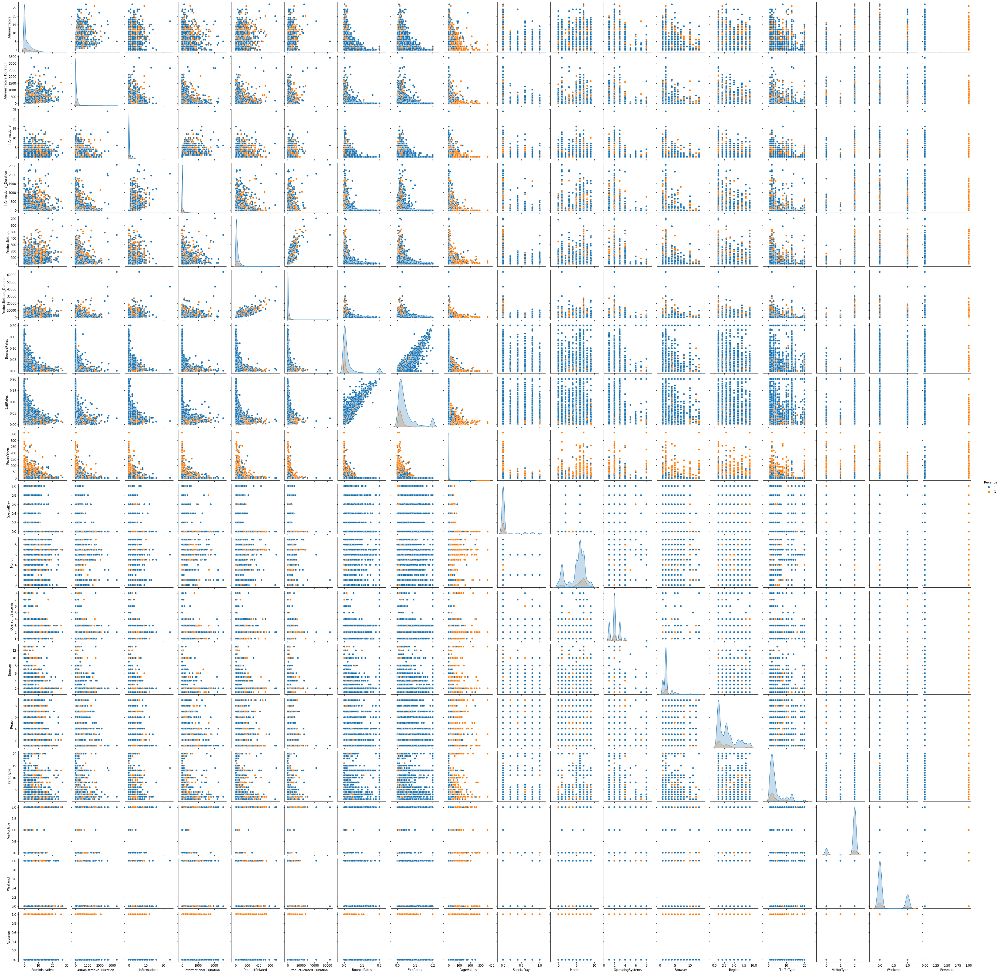

In [10]:
sns.pairplot(dataset, x_vars=dataset.columns, y_vars=dataset.columns, hue='Revenue', diag_kind='kde')


## PreProcessing

### Encoding

In [11]:
le = LabelEncoder()

dataset['VisitorType'] = le.fit_transform(dataset['VisitorType'])
dataset['VisitorType'].unique()

dataset['Weekend'] = le.fit_transform(dataset['Weekend'])
dataset['Weekend'].unique()

dataset['Revenue'] = le.fit_transform(dataset['Revenue'])
dataset['Revenue'].unique()

dataset.drop(['Month'], axis=1, inplace=True)

dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12330 entries, 0 to 12329
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12330 non-null  int64  
 1   Administrative_Duration  12330 non-null  float64
 2   Informational            12330 non-null  int64  
 3   Informational_Duration   12330 non-null  float64
 4   ProductRelated           12330 non-null  int64  
 5   ProductRelated_Duration  12330 non-null  float64
 6   BounceRates              12330 non-null  float64
 7   ExitRates                12330 non-null  float64
 8   PageValues               12330 non-null  float64
 9   SpecialDay               12330 non-null  float64
 10  OperatingSystems         12330 non-null  int64  
 11  Browser                  12330 non-null  int64  
 12  Region                   12330 non-null  int64  
 13  TrafficType              12330 non-null  int64  
 14  VisitorType           

In [12]:

#dataset.drop(columns=['Month'], inplace=True)

X = dataset.iloc[:, :-1].values
y = dataset.iloc[:, -1].values

### Independent Features Categorical Encoding

### Spliting Dataset into Training and Test set


In [13]:
from sklearn.model_selection import train_test_split as tts
X_train, X_test, y_train, y_test = tts(X, y, test_size=0.2, random_state=42)

In [14]:
X_array = dataset.drop('Revenue', axis=1)
y_array = dataset['Revenue']

### Feature Scaling

In [15]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()

X_train[:, :10] = sc.fit_transform(X_train[:, :10])
X_test[:, :10] = sc.transform(X_test[:, :10])

X_train[:, 11:15] = sc.fit_transform(X_train[:, 11:15])
X_test[:, 11:15] = sc.transform(X_test[:, 11:15])


### Feature Selection using Chi2

In [16]:
from sklearn.feature_selection import chi2
chi_scores = chi2(X_array, y_array)

p_values = pd.Series(chi_scores[1], index = X_array.columns)
p_values.sort_values(ascending = False , inplace = True)


In [17]:
p_values.plot.bar(title = "Feature P-values")

Since "OpertingSystems" has higher the p-value, it says that this variables is independent of the repsone and can not be considered for model training

In [18]:
k = 13

In [19]:
from sklearn.feature_selection import SelectKBest

fs = SelectKBest(score_func=chi2, k=k)
# apply feature selection
X_selected = fs.fit_transform(X_array, y_array)
column_names = dataset.columns
top_features = sorted(zip(column_names, fs.scores_), key=lambda x: x[1], reverse=True)
print(top_features)
# print(func.scores_)
X_selected.shape


[('ProductRelated_Duration', 877404.3394145007), ('PageValues', 175126.8085117636), ('Administrative_Duration', 41754.83684116535), ('Informational_Duration', 35059.77577010407), ('ProductRelated', 19317.285376075673), ('Administrative', 1133.9655314221452), ('Informational', 357.9816052416834), ('SpecialDay', 53.79709448024535), ('VisitorType', 37.547522724557325), ('BounceRates', 29.65433592569568), ('ExitRates', 28.985072085022203), ('Browser', 8.873291350963802), ('Weekend', 8.12046424762299), ('Region', 3.037565294394644), ('TrafficType', 1.283194323402084), ('OperatingSystems', 1.037132256259164)]


(12330, 13)

In [20]:
# ANOVA feature selection for numeric input and categorical output
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
# generate dataset
# X, y = make_classification(n_samples=100, n_features=20, n_informative=2)
# define feature selection
anova = f_classif(X_array, y_array)
anova_scores = pd.Series(anova[1], index = X_array.columns)
anova_scores.sort_values(ascending = False , inplace = True)


In [21]:
anova_scores.plot.bar(title = "Feature ANOVA Scores")

In [22]:
# !pip3 install --upgrade nbformat


Given the imbalance in the class distributions we will consider some rebalancing strategies, in particular **SMOTE for oversampling** and **Near Miss for undersampling**, which can be a viable option since our dataset is quite large in size.

## PCA Visualisation 

In [14]:
import plotly.express as px
from sklearn.decomposition import PCA


pca = PCA(n_components=3)
components = pca.fit_transform(X)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=dataset['Revenue'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

In [16]:
!pip3 install dash

In [18]:
import plotly.express as px
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA

pca = PCA()
pca.fit(dataset)
exp_var_cumul = np.cumsum(pca.explained_variance_ratio_)

px.area(
    x=range(1, exp_var_cumul.shape[0] + 1),
    y=exp_var_cumul,
    labels={"x": "# Components", "y": "Explained Variance"}
)

In [24]:
def isolation_forest(X, y, n_estimators=100):
    X = np.asarray(X)
    y = np.asarray(y)

    outliers = IsolationForest(n_estimators = n_estimators, n_jobs = -1).fit_predict(X)
    X = X[outliers == 1, :]
    y = y[outliers == 1]

    return (X, y)
    

In [25]:
def lof(X, y, n_neighbors = 20):
    X = np.asarray(X)
    y = np.asarray(y)

    outliers = LOF(n_neighbors = n_neighbors, n_jobs = -1).fit_predict(X)
    X = X[outliers == 1, :]
    y = y[outliers == 1]

    return (X, y)
    

In [26]:
def detect_outliers(X, method=None, n=None):
    if method not in ['lof', 'iforest']:
        print("Select different method")
    else:
        if method == 'lof':
            outliers = LOF(n_neighbors=n, n_jobs=-1).fit_predict(X)
        elif method == 'iforest':
            outliers = IsolationForest(n_estimators=n ,n_jobs=-1).fit_predict(X)

        print(f'{method}: {np.count_nonzero(outliers == -1)} outliers found')



In [27]:
n = [10, 20, 40, 80]

for neighbors in n:
    detect_outliers(X, method='lof', n=neighbors)

lof: 823 outliers found
lof: 900 outliers found
lof: 1102 outliers found
lof: 1350 outliers found


In [28]:
n = [100, 200, 400, 800]

for estimators in n:
    detect_outliers(X, method='iforest', n=neighbors)

iforest: 978 outliers found
iforest: 1010 outliers found
iforest: 1075 outliers found
iforest: 1092 outliers found


# Classification Task


In [29]:
def train(X_train, y_train, X_test, y_test, param_grid, test_size=0.2, outlier=None, scale=False, pca=0, rebalancing=None, clf=None):
    if clf is not None:

        steps = []
        if outlier is not None and outlier == 'iforest':
            steps.append(("outlier", FunctionSampler(func=isolation_forest)))
        elif outlier is not None and outlier == 'lof':
            steps.append(("outlier", FunctionSampler(func=lof)))
        if scale:
            steps.append(("scaler", StandardScaler()))
        if pca > 0:
            steps.append(("pca", PCA(n_components = pca, svd_solver='full')))
        if rebalancing is not None:
            if rebalancing == 'over':
                steps.append(("smote", SMOTE(n_jobs=-1)))
            elif rebalancing == 'under':
                steps.append(("nearmiss", NearMiss(version=3)))
        if clf == 'svc':
            steps.append(('nystroem', Nystroem(n_jobs=-1)))
            steps.append(('classifier', LinearSVC()))
        elif clf == 'knn':
            steps.append(('classifier', KNeighborsClassifier()))
        elif clf == 'random_forest':
            steps.append(('classifier', RandomForestClassifier()))

        pipeline = ImbalancedPipeline(steps)

        gridsearch = GridSearchCV(pipeline, param_grid, scoring='f1', n_jobs=-1)
        gridsearch.fit(X_train, y_train)
        return gridsearch
    else:
        print("Select valid classifier")

def predict(gridsearch, X_test, y_test):
    print("Predicting..")
    best_estimator = gridsearch.best_estimator_
    y_pred = best_estimator.predict(X_test)
    f1 = f1_score(y_test, y_pred)
    print(f"Best model with parameters: {gridsearch.best_params_}\nF1-score: {f1}")
    return f1

## Random Forest

In [43]:
from sklearn.ensemble import RandomForestClassifier

def random_forest_classifier(X, y, X_test, y_test):
    RF_classifier = RandomForestClassifier(n_estimators=100, random_state=42, criterion='gini', n_jobs=-1)
    RF_classifier.fit(X, y)    
    RF_y_pred = RF_classifier.predict(X_test)
    f1 = metrics(RF_y_pred, y_test)
    return f1

In [44]:
random_forest_classifier(X_train, y_train, X_test, y_test)

0.6112676056338028

In [32]:



rf_scores = []
rf_scores.append([])

## PARAMS
param_grid = {
    "classifier__n_estimators": [100, 200, 500, 1000],
    "classifier__criterion": ["gini", "entropy"],
    "classifier__max_features": ["auto", "sqrt", "log2"],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET")
gridsearch = train(X_train, y_train, X_test, y_test, param_grid, clf="random_forest")
print("Predicting..")
rf_scores[0].append(predict(gridsearch, X_test, y_test))

"""
## PCA
print("\nPCA")
dataset.train(param_grid, pca=6, scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## SMOTE
print("\nSMOTE")
dataset.train(param_grid, rebalancing="over", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## SMOTE + PCA
print("\nSMOTE + PCA")
dataset.train(param_grid, pca=6, rebalancing="over", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## NEARMISS
print("\nNEAR MISS")
dataset.train(param_grid, rebalancing="under", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())

## NEARMISS + PCA
print("\nNEAR MISS + PCA")
dataset.train(param_grid, pca=6, rebalancing="under", scale=True, clf="random_forest")
print("Predicting..")
rf_scores[0].append(dataset.predict())
"""

ORIGINAL DATASET


KeyboardInterrupt: 

## Decision Tree


In [ ]:
from sklearn.tree import DecisionTreeClassifier

def decision_tree_classification(X, y, X_test):

    DT_classifier = DecisionTreeClassifier(criterion='gini', random_state=42)
    DT_classifier.fit(X, y)
    
    DT_y_pred = DT_classifier.predict(X_test)

    return DT_y_pred



## KNN


In [ ]:
from sklearn.neighbors import KNeighborsClassifier

def KNN_classification(X, y, X_test, y_test):
    KNN_classifier = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2)
    KNN_classifier.fit(X, y)

    KNN_y_pred = KNN_classifier.predict(X_test)
    
    f1 = f1_score(y_test, KNN_y_pred)
    return f1

In [ ]:
print(KNN_classification(X_train, y_train, X_test, y_test))

0.4992101105845181


In [ ]:
knn_scores = []
knn_scores.append([])

## PARAMS
param_grid = {
    "classifier__n_neighbors": [10, 50, 100],
    "classifier__weights": ["uniform", "distance"],
    "classifier__algorithm": ["auto", "ball_tree", "kd_tree", "brute"],
    "classifier__leaf_size": [20,40,60],
    "classifier__n_jobs": [-1],
}

## ORIGINAL DATASET
print("ORIGINAL DATASET")
gridsearch, X_test, y_test = train(X, y, param_grid, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

## PCA
print("\nPCA")
gridsearch, X_test, y_test = train(X, y, param_grid, pca=6, scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

## SMOTE
print("\nSMOTE")
gridsearch, X_test, y_test = train(X, y, param_grid, rebalancing="over", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

## SMOTE + PCA
print("\nSMOTE + PCA")
gridsearch, X_test, y_test = train(X, y, param_grid, pca=6, rebalancing="over", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

## NEARMISS
print("\nNEAR MISS")
gridsearch, X_test, y_test = train(X, y, param_grid, rebalancing="under", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

## NEARMISS + PCA
print("\nNEAR MISS + PCA")
gridsearch, X_test, y_test = train(X, y, param_grid, pca=6, rebalancing="under", scale=True, clf="knn")
print("Predicting..")
knn_scores[0].append(predict(gridsearch, X_test, y_test))

ORIGINAL DATASET
Predicting..
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance'}
F1-score: 0.3805970149253731

PCA
Predicting..
Predicting..
Best model with parameters: {'classifier__algorithm': 'auto', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 10, 'classifier__weights': 'distance'}
F1-score: 0.2815734989648033

SMOTE
Predicting..
Predicting..
Best model with parameters: {'classifier__algorithm': 'ball_tree', 'classifier__leaf_size': 60, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 100, 'classifier__weights': 'uniform'}
F1-score: 0.5245316681534343

SMOTE + PCA
Predicting..
Predicting..
Best model with parameters: {'classifier__algorithm': 'ball_tree', 'classifier__leaf_size': 20, 'classifier__n_jobs': -1, 'classifier__n_neighbors': 50, 'classifier__weights': 'distance'}
F1-score: 0.4336618650492

## Logistic Regression


In [ ]:
from sklearn.linear_model import LogisticRegression

def LogisticRegression_classification(X, y, X_test):
    LR_classifier = LogisticRegression(solver='lbfgs', random_state=42)
    LR_classifier.fit(X, y)

    LR_y_pred = LR_classifier.predict(X_test)

    return LR_y_pred


## SVM 

In [ ]:
from sklearn.svm import SVC

def SVM_classification(X, y, X_test):
    SVM_classifier = SVC(kernel='rbf', random_state=42)
    SVM_classifier.fit(X, y)

    SVM_y_pred = SVM_classifier.predict(X_test)

    return SVM_y_pred